<a href="https://colab.research.google.com/github/virajvaidya/Perseverance/blob/main/Perseverance.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import json
import requests
import re
import imageio
import datetime

import matplotlib.pyplot as plt
import pandas            as pd
import seaborn           as sb

from skimage             import transform, io, data
from skimage.viewer      import ImageViewer

%matplotlib inline


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: Viewer requires Qt
  if sys.path[0] == '':


In [2]:
apikey   = 'DEMO_KEY'
apiurl   = 'https://api.nasa.gov/mars-photos/api/v1/rovers/perseverance/photos'
apiurlm  = 'https://api.nasa.gov/mars-photos/api/v1/manifests/perseverance'
earthdate= '2021-02-18'
camera   = 'all'
page     = '1'
sb.set(rc={"figure.figsize": (30,10)})

In [4]:
response = requests.get(apiurlm, params={'api_key':apikey})

In [5]:
a = json.loads(response.text)
print(type(a))
df= pd.DataFrame(a)
df

<class 'dict'>


,photo_manifest
landing_date,2021-02-18
launch_date,2020-07-30
max_date,2021-11-18
max_sol,266
name,Perseverance
photos,"[{'sol': 0, 'earth_date': '2021-02-18', 'total..."
status,active
total_photos,37278


In [6]:
b=df['photo_manifest']['photos']
pf=pd.DataFrame(b)
pf['earth_datep']=pd.to_datetime(pf['earth_date'])
c=pf.query('earth_datep>="2021-02-18"')
c.sort_values(by=['earth_datep'])

,sol,earth_date,total_photos,cameras,earth_datep
0,0,2021-02-18,54,"[EDL_DDCAM, FRONT_HAZCAM_LEFT_A, FRONT_HAZCAM_...",2021-02-18
1,1,2021-02-19,201,"[EDL_DDCAM, EDL_PUCAM2, EDL_RDCAM, EDL_RUCAM, ...",2021-02-19
2,2,2021-02-20,899,"[EDL_PUCAM1, EDL_RDCAM, FRONT_HAZCAM_LEFT_A, F...",2021-02-20
3,3,2021-02-21,286,"[MCZ_LEFT, MCZ_RIGHT]",2021-02-21
4,4,2021-02-22,437,"[EDL_DDCAM, EDL_RDCAM, MCZ_LEFT, MCZ_RIGHT, NA...",2021-02-22
...,...,...,...,...,...
238,262,2021-11-14,93,"[FRONT_HAZCAM_LEFT_A, FRONT_HAZCAM_RIGHT_A, MC...",2021-11-14
239,263,2021-11-15,52,"[FRONT_HAZCAM_LEFT_A, FRONT_HAZCAM_RIGHT_A, SU...",2021-11-15
240,264,2021-11-16,77,"[MCZ_LEFT, MCZ_RIGHT, NAVCAM_LEFT, SKYCAM, SUP...",2021-11-16
241,265,2021-11-17,328,"[MCZ_LEFT, MCZ_RIGHT, NAVCAM_LEFT, SKYCAM, SUP...",2021-11-17


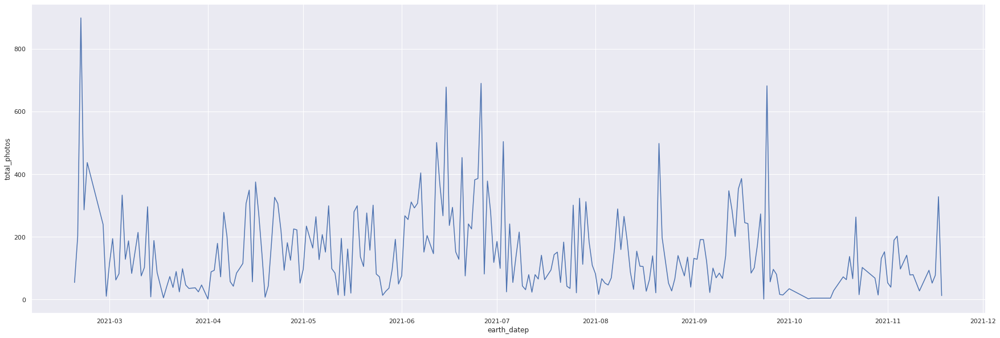

In [7]:
ax = sb.lineplot(x="earth_datep", y="total_photos", 
                  data=c)

In [8]:
earthdate='2021-02-18'
responsep = requests.get(apiurl, params={'earth_date': earthdate,'api_key':apikey})

In [9]:
a=json.loads(responsep.text)
df=pd.DataFrame(a['photos'])
b=df['img_src']

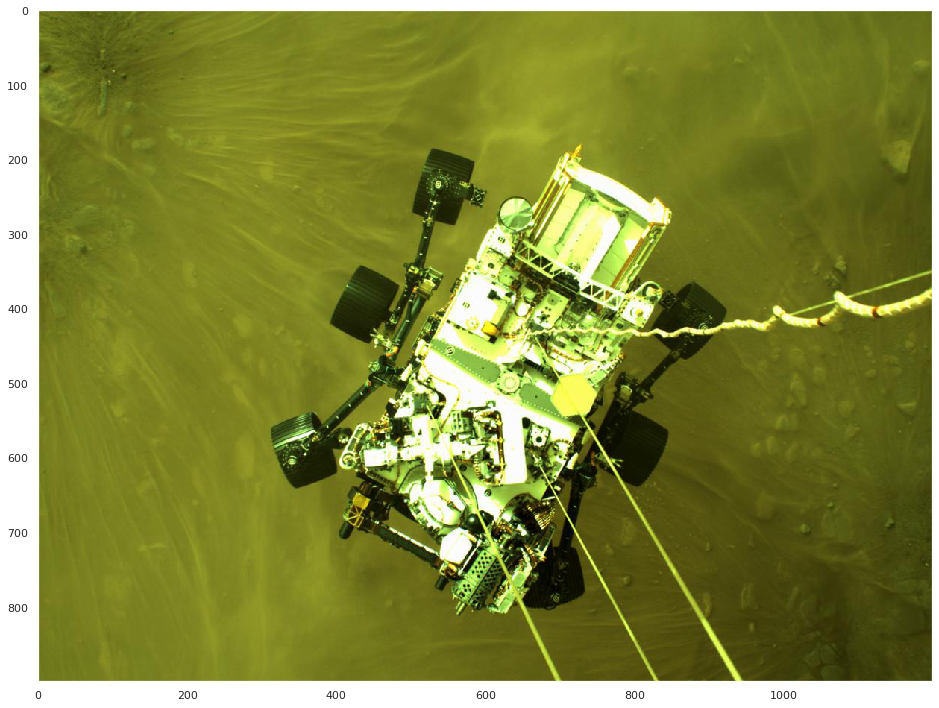

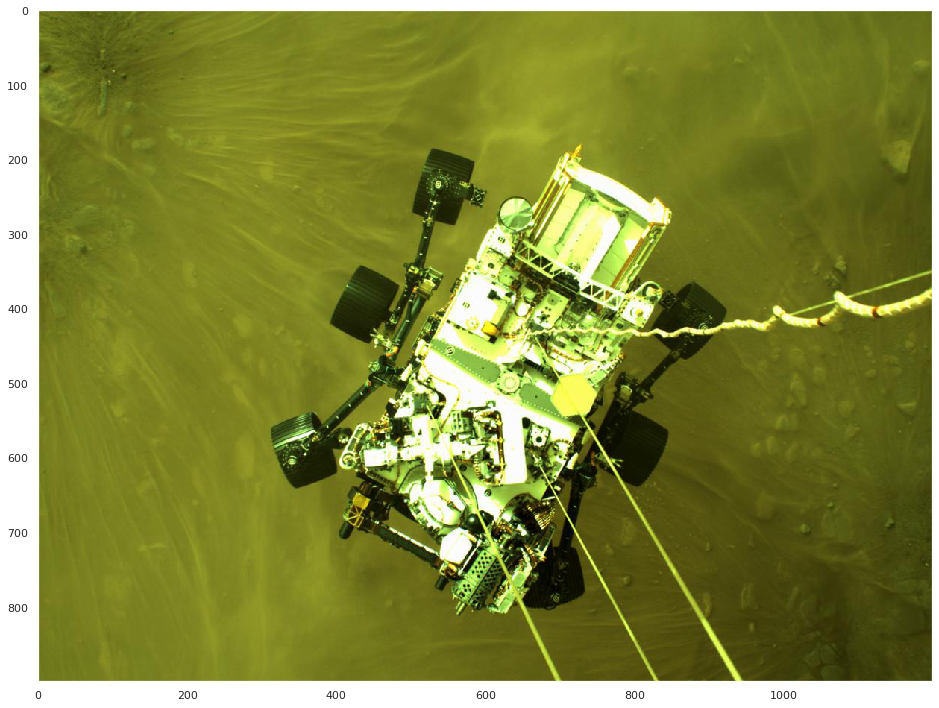

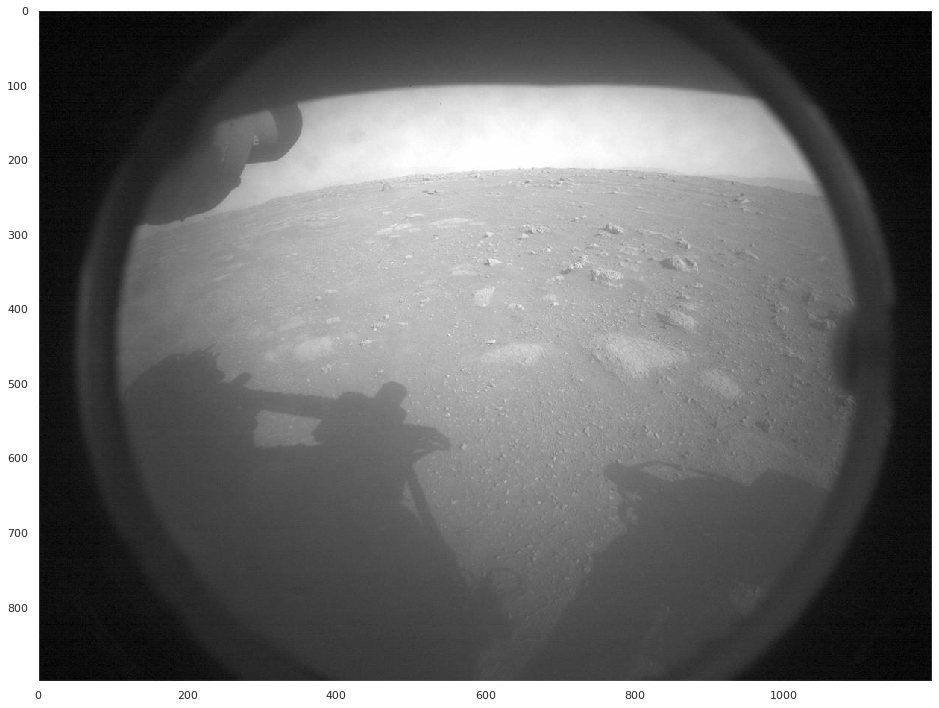

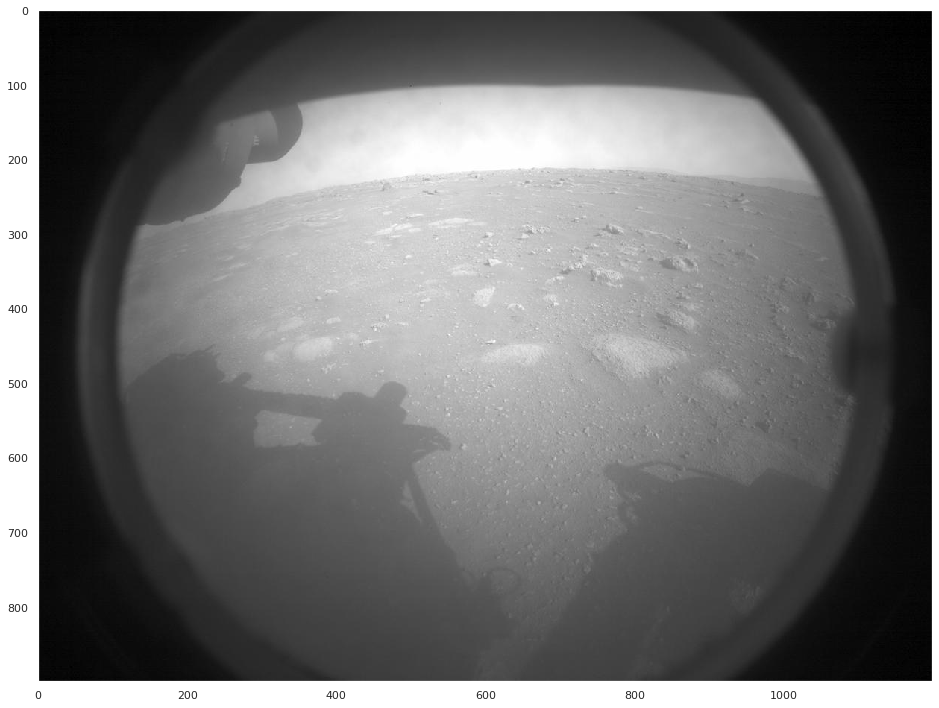

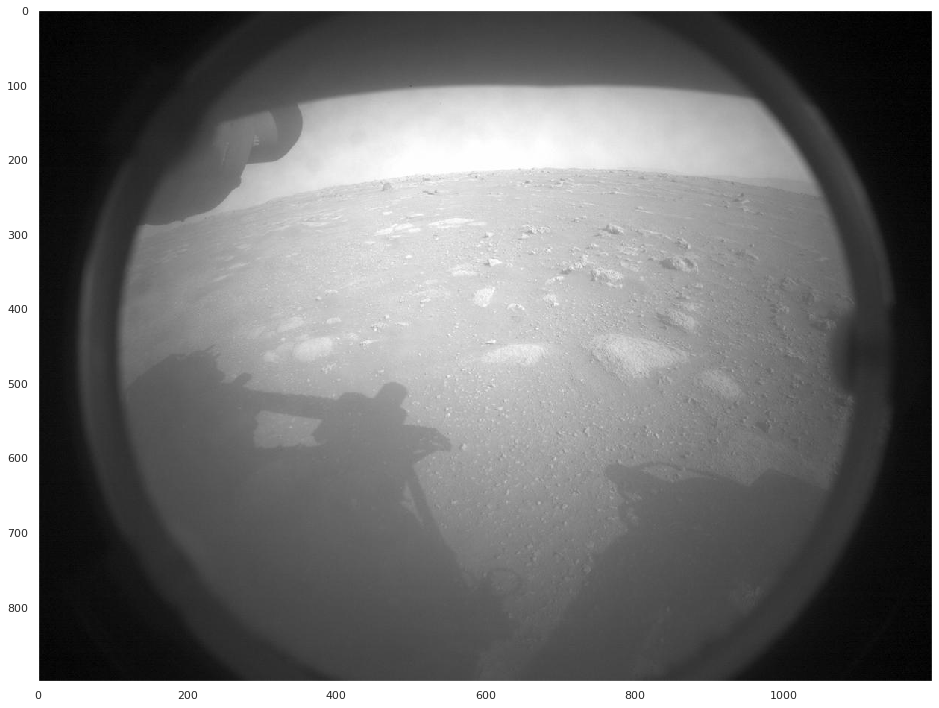

...

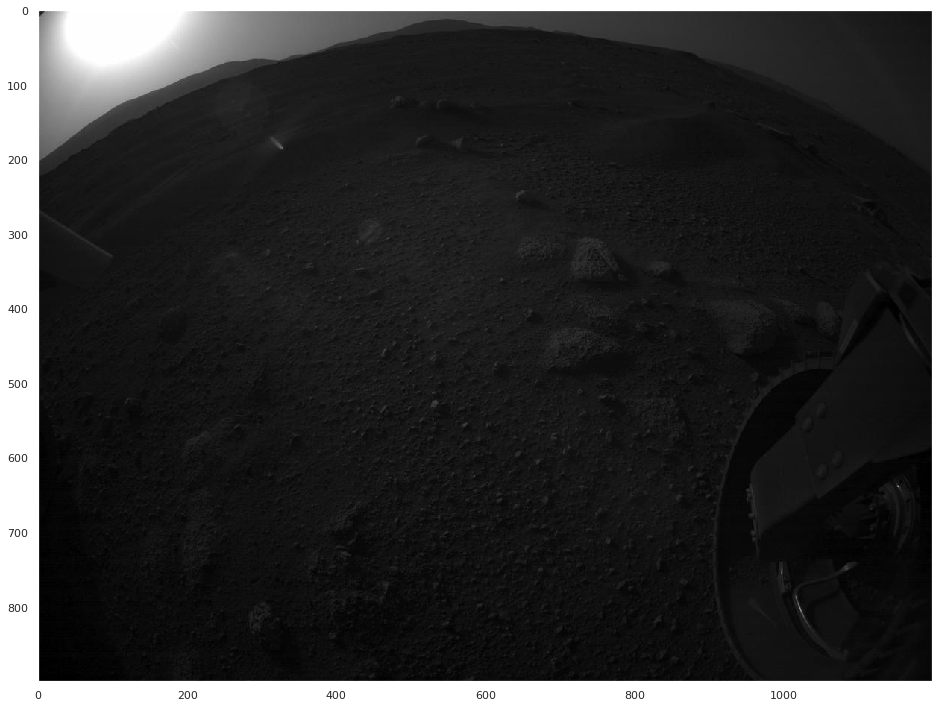

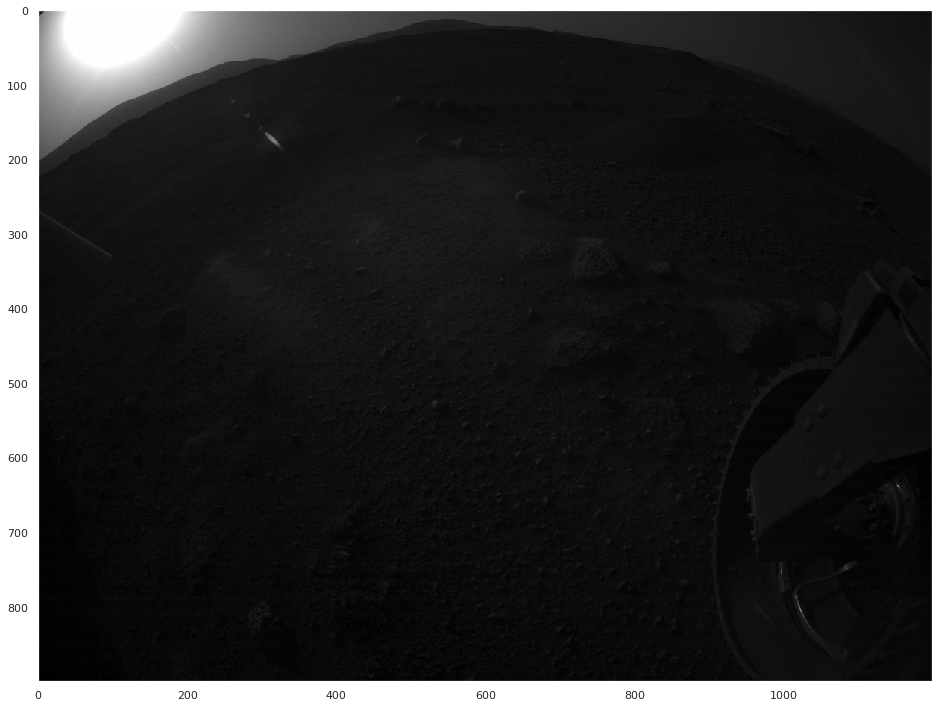

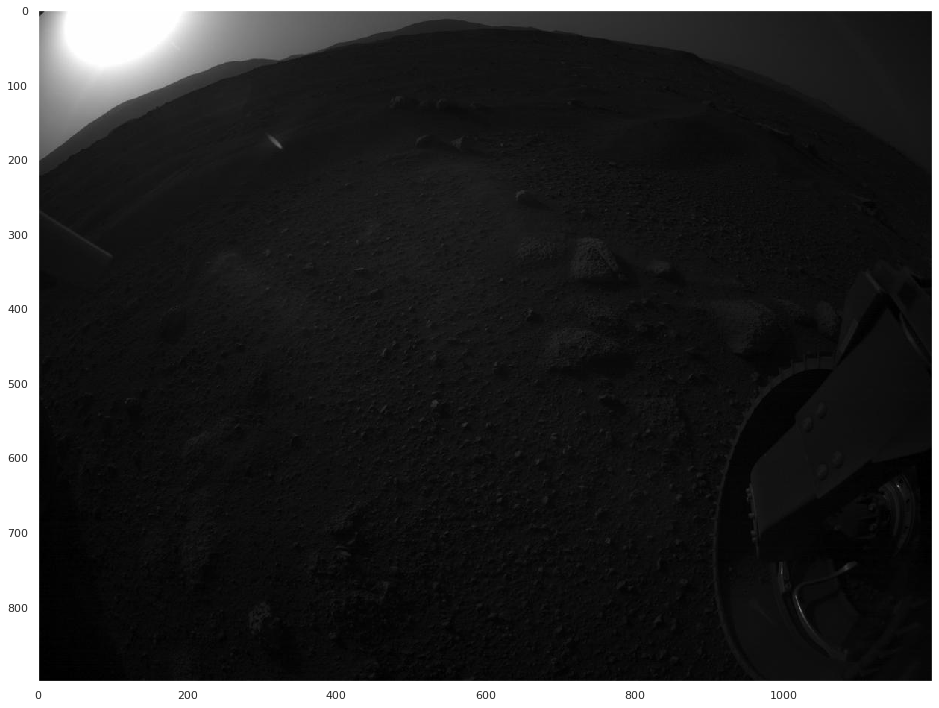

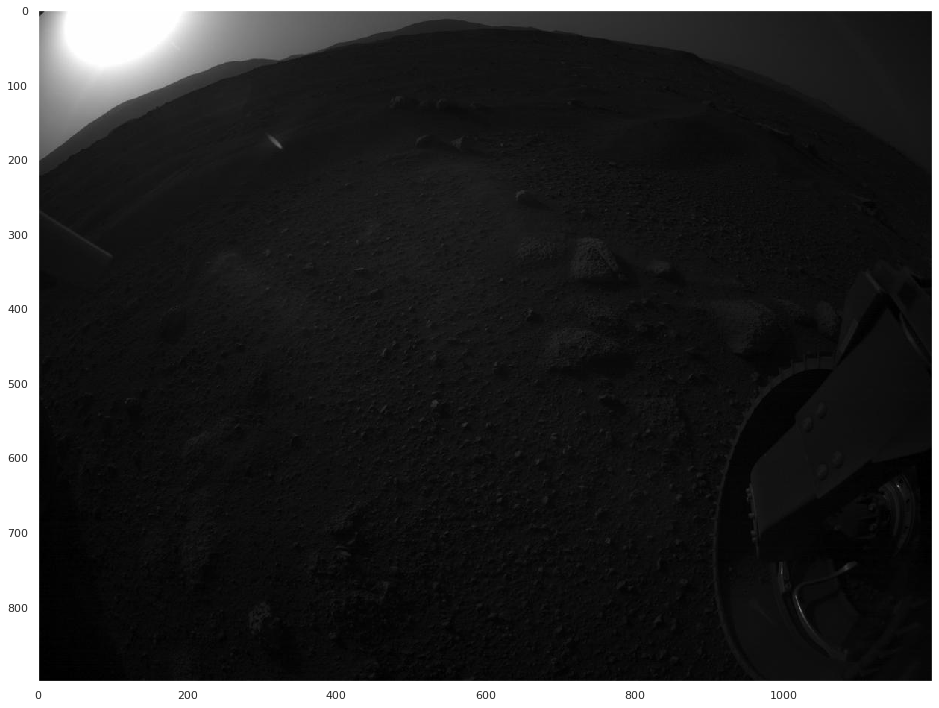

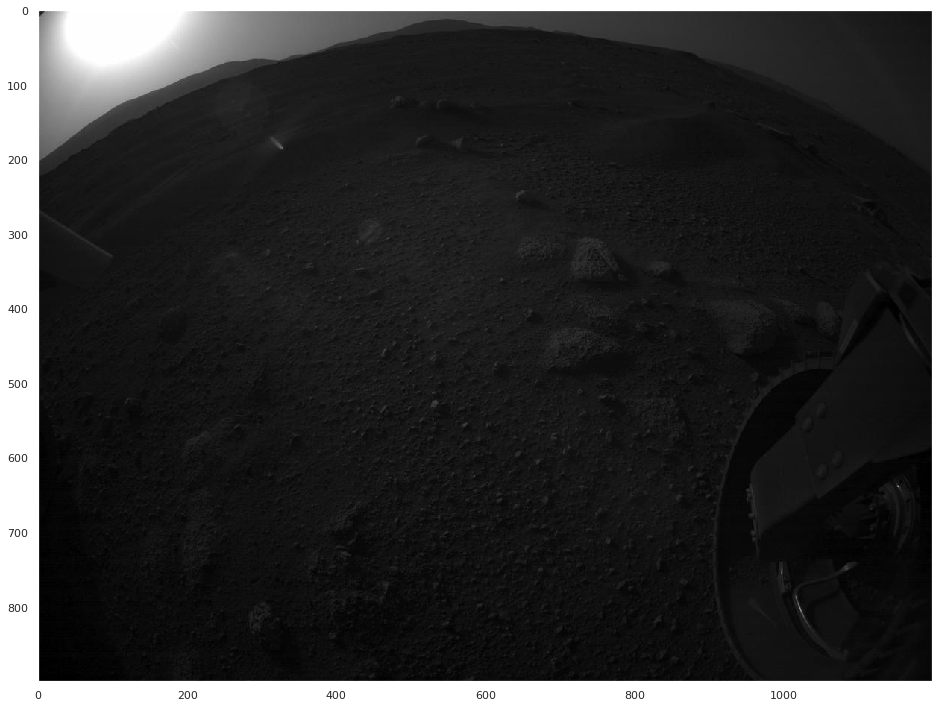

In [10]:
for i in b:
    image = io.imread(i)
    io.imshow(image)
    plt.grid(b=None)
    io.show()
